# **Lab4 : Image Segmentation (Histogram of Oriented Gradients & K-Mean Clustering)**

In [14]:
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from skimage.feature import hog
from skimage import measure


import glob

from sklearn.cluster import KMeans

from scipy import spatial

from tqdm import tqdm
import cv2
import os 
import random

## Load Image

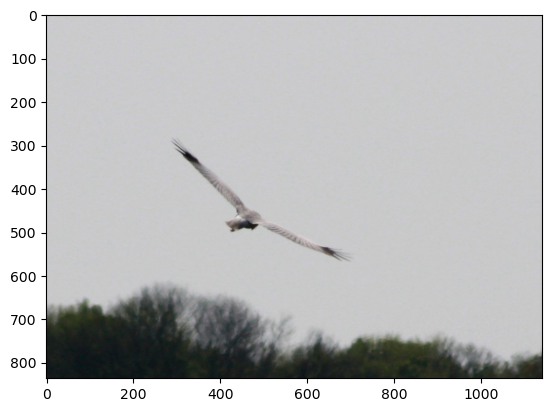

In [15]:
### START CODE HERE ###
image = cv2.imread('images/bird.jpg')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
plt.imshow(image)
plt.show()
### END CODE HERE ###

## Histogram of Oriented Gradients

Blur the image then apply to the [`hog()`](<https://scikit-image.org/docs/stable/api/skimage.feature.html#skimage.feature.hog:~:text=skimage.feature.hog(,%23>)
<details>

<summary>
<font size="3" color="orange">
<b>Expected output</b>
</font>
</summary>

- The output should resemble this, but not be identical

![image.png](https://github.com/Digital-Image-Processing-Laboratory/image_processing-2024/blob/master/Lab4_Image-Segmentation/asset/1.png?raw=true)
</details>

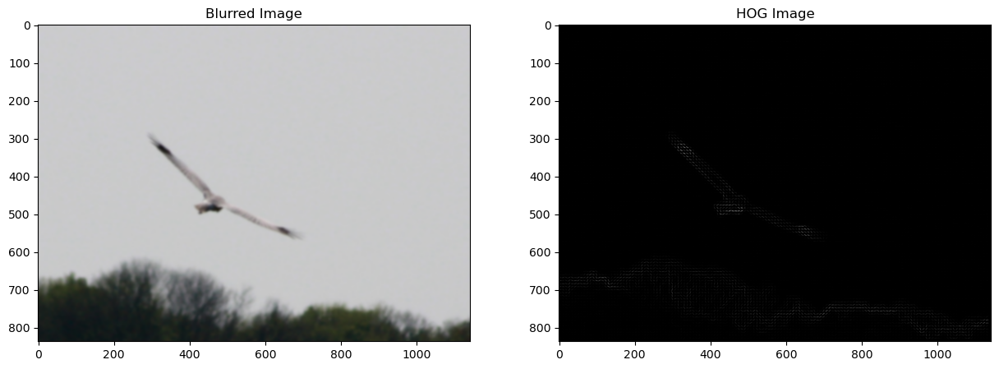

In [16]:
### START CODE HERE ###

blurred_image = cv2.GaussianBlur(image,(15,15),0)
''' 
(kx,ky):    คือขนาดของเคอร์เนล (kernel) ที่ใช้ในการคำนวณค่าพิกเซลใหม่ของภาพ โดยตัวเลขทั้งสองแทนจำนวนแถวและจำนวนคอลัมน์ของเคอร์เนล 
            ยิ่งขนาดของเคอร์เนลใหญ่เท่าไหร่ เอฟเฟกต์เบลอก็จะยิ่งมากขึ้นเท่านั้น (The kernel size needs to be odd to ensure proper Gaussian filtering.)
0:          คือค่า sigma X ซึ่งเป็นพารามิเตอร์ที่ควบคุมความกว้างของการกระจายแบบเกาส์เซียน หากค่า sigma X มีค่ามาก ความเบลอก็จะยิ่งมากขึ้น
'''

#hog function expects a grayscale image (2D array) not a color image (3D array with color channels)
gray_blurred_image  = cv2.cvtColor(blurred_image, cv2.COLOR_BGR2GRAY)

''' 
orientations (จำนวนทิศทาง (bins)/ขนาดของแต่ละช่วง) : (360 องศา / 9 ช่วง = 40 องศา)
'''
fd, hog_image = hog(gray_blurred_image, orientations=9, pixels_per_cell=(8, 8), cells_per_block=(2, 2), visualize=True)

fig, axs = plt.subplots(1, 2, figsize=(15, 5))

axs[0].imshow(blurred_image)  
axs[0].set_title('Blurred Image')

axs[1].imshow(hog_image, cmap='gray') 
axs[1].set_title('HOG Image')

plt.show()
### END CODE HERE ###

Complete the `HOGSubimageExtractor()`.

That extracts Histogram of Oriented Gradients features from sub-images of a larger image. It divides the image into overlapping tiles, computes HOG features for each tile, and stores both the feature vectors and visualizations. The class also provides a method to plot the HOG visualizations.

**Attributes:**
- `image`: The input image.
- `tile_size`: The size of each sub-image to extract.
- `stride`: The pixel stride between consecutive sub-images.
- `hGrid`: An array of indices representing the starting positions for rows of sub-images.
- `wGrid`: An array of indices representing the starting positions for columns of sub-images.
- `hog_features`: A list to store the HOG feature vectors for each sub-image.
- `hog_images`: A list to store the visualized HOG images for each sub-image (optional).

**Methods:**
- `extract_hog_features()`: Compute HOG features for each sub-image.
- `plot_hog_images()`: Plots the HOG visualization images.
- `get_num_grid()`: Return the number of rows and columns in the grid of sub-images.


In [17]:
### START CODE HERE ###
class HOGSubimageExtractor:
    def __init__(self, image, tile_size, stride):
        # Process the image: convert to grayscale and apply Gaussian blur
        processed_image = self.preprocess_image(image)
        
        # Resize the image so that dimensions are divisible by both tile_size and stride
        # self.image = self.resize_image_to_divisible(self.processed_image, tile_size, stride)
        self.image = processed_image
        
        self.tile_size = tile_size
        self.stride = stride
        self.h, self.w = self.image.shape[:2]
        self.hGrid, self.wGrid = self.compute_grid_indices()
        self.hog_features = []
        self.hog_images = []
        self.extract_hog_features()

    def preprocess_image(self, image):
        gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        blurred_image = cv2.GaussianBlur(gray_image, (15, 15), 0)
        return blurred_image

    # def resize_image_to_divisible(self, image, tile_size, stride):
    #     h, w = image.shape

    #     # Compute new dimensions that are multiples of stride
    #     new_h = (h // stride) * stride
    #     new_w = (w // stride) * stride

    #     # Ensure new dimensions are multiples of tile_size
    #     if new_h % tile_size != 0:
    #         new_h = ((new_h // tile_size) + 1) * tile_size
    #     if new_w % tile_size != 0:
    #         new_w = ((new_w // tile_size) + 1) * tile_size

    #     # Resize the image to the new dimensions
    #     resized_image = cv2.resize(image, (new_w, new_h))
    #     return resized_image

    def compute_grid_indices(self):
        # Compute grid indices for rows and columns
        hGrid = range(0, self.h - self.tile_size + 1, self.stride)
        wGrid = range(0, self.w - self.tile_size + 1, self.stride)
        return hGrid, wGrid

    def extract_hog_features(self):
        orientations = 9
        pixels_per_cell = (8, 8)
        cells_per_block = (2, 2)
        
        for y in self.hGrid:
            for x in self.wGrid:
                tile = self.image[y:y+self.tile_size, x:x+self.tile_size]
                fd, hog_image = hog(tile, orientations, pixels_per_cell, cells_per_block, visualize=True, channel_axis=None)
                self.hog_features.append(fd)
                self.hog_images.append(hog_image)

    def plot_hog_images(self):
        num_rows = len(self.hGrid)
        num_cols = len(self.wGrid)
        
        fig, axes = plt.subplots(num_rows, num_cols, figsize=(num_cols , num_rows))
        axes = axes.flatten()
    
        for idx, ax in enumerate(axes):
            if idx < len(self.hog_images):
                ax.imshow(self.hog_images[idx], cmap='gray')
                ax.axis('off')  # Turn off axis
            else:
                ax.axis('off')  # Hide extra subplots if any
        plt.subplots_adjust(wspace=0, hspace=0)
        plt.tight_layout(pad=0)
        plt.show()

    def get_num_grid(self):
        return len(self.hGrid), len(self.wGrid)
### END CODE HERE ###


Let's use `HOGSubimageExtractor()` in the cell below.
<details>

<summary>
<font size="3" color="orange">
<b>Expected output from hog_extractor.plot_hog_images()</b>
</font>
</summary>

- The output should resemble this, but not be identical

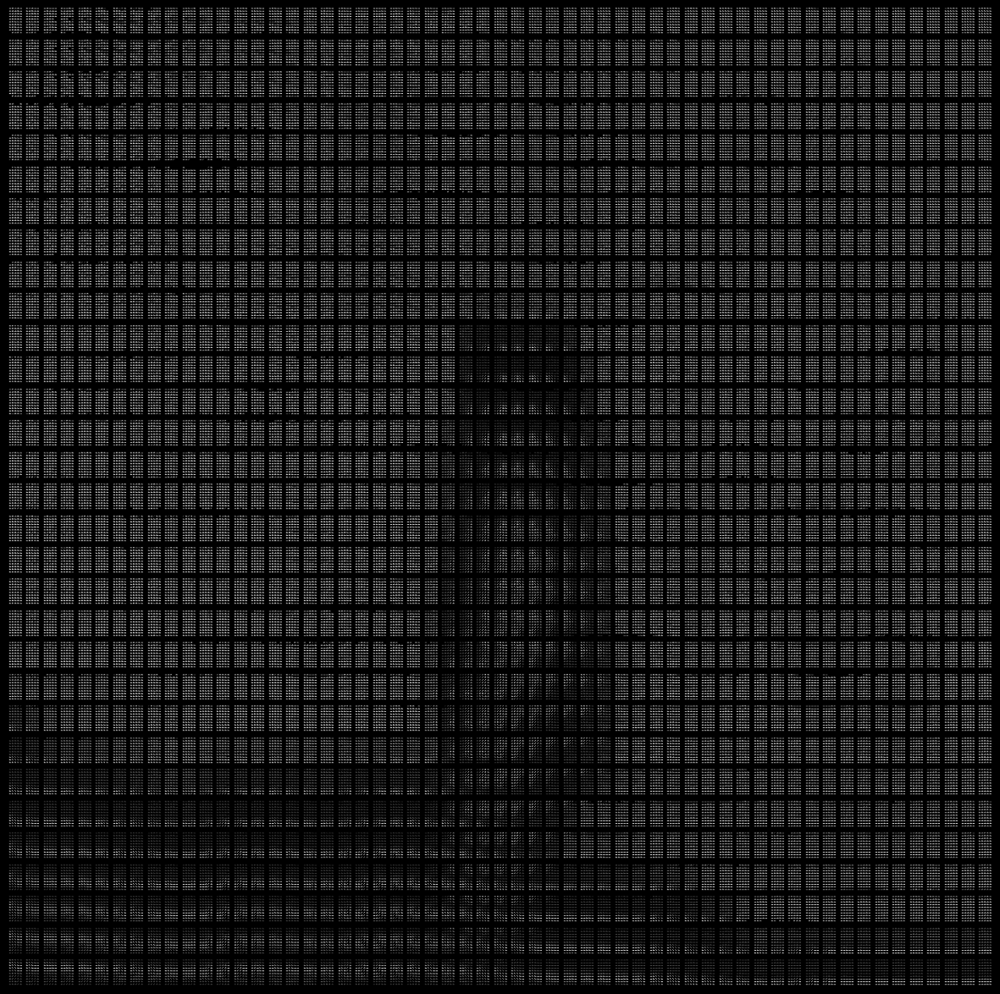
</details>

Number of grids: (25, 34)


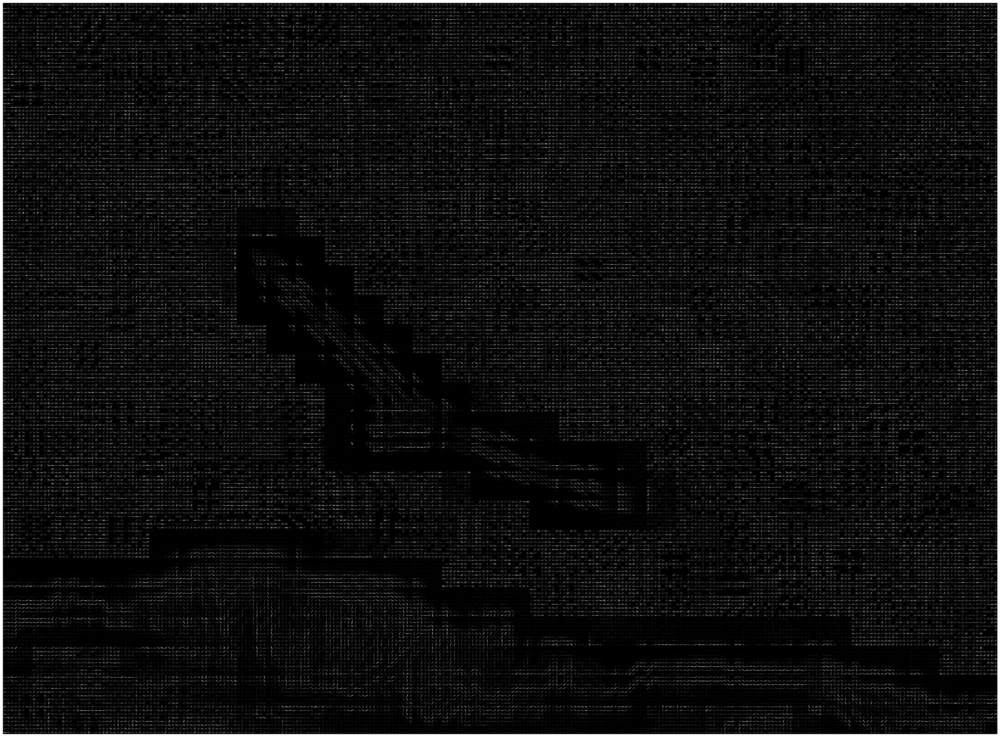

In [18]:
### START CODE HERE ###
tile_size = 64
stride = 32
hog_extractor = HOGSubimageExtractor(image, tile_size, stride)
num_grid = hog_extractor.get_num_grid()
print(f'Number of grids: {num_grid}')
hog_extractor.plot_hog_images()
### END CODE HERE ###

## K-Mean Clustering
Complete the `KMeansCluster()`.
Perform K-means clustering on Histogram of Oriented Gradients (HOG) features extracted from an image.
**Attriburtes:**
- `hog_extractor`: An object responsible for extractin HOG features from an image.
- `n_clusters`: The number of clusters to use in K-means.
- `cluster_array`: A 2D array representing the cluster assignments for each grid cell.
- `all_labels`: A 2D array representing the connected components (objects) identified after clustering.
- `bounding_boxes`: A list of tuples containing (object_id, start_coordinates, end_coordinates) for each detected object.

**Method:**
- `perform_clustering()`: Performs K-means clustering on the HOG features extracted by the hog_extractor object.<br>
It then reshapes the cluster assignmentss into a grid and identifies connected components using the `measure.label()` function.
- `plot_cluster_and_labels()`: Visualize the cluster assignments and connected components as images using Matplotlib.
- `get_bounding_boxes()`: Extracts bounding boxes for each detected object.

In [19]:
### START CODE HERE ###
class KMeansCluster:
    def __init__(self, hog_extractor, n_clusters, random_state=42):
        self.hog_extractor = hog_extractor
        self.n_clusters = n_clusters
        self.random_state = random_state
        self.cluster_array = None
        self.all_labels = None
        self.bounding_boxes = []
        self.perform_clustering()

    def perform_clustering(self):
        # Perform K-means clustering on the HOG features
        kmeans = KMeans(n_clusters=self.n_clusters, n_init=10, random_state=self.random_state)
        kmeans.fit(self.hog_extractor.hog_features)

        # Reshape the cluster labels to the grid shape
        self.cluster_array = kmeans.labels_.reshape(len(self.hog_extractor.hGrid), len(self.hog_extractor.wGrid))

        # Identify connected components (objects) in the cluster array
        self.all_labels = measure.label(self.cluster_array)

    def plot_cluster_and_labels(self):
        # Plot cluster assignments
        fig, axes = plt.subplots(1, 2, figsize=(12, 5))

        # Cluster assignments
        im1 = axes[0].imshow(self.cluster_array)
        axes[0].set_title('Cluster Assignments')

        # Connected components
        im2 = axes[1].imshow(self.all_labels)
        axes[1].set_title('Connected Components')
        fig.colorbar(im2, ax=axes[1])

        plt.show()

    def get_bounding_boxes(self):
        # Extract bounding boxes for each detected object
        for region in measure.regionprops(self.all_labels):
            min_row, min_col, max_row, max_col = region.bbox
            self.bounding_boxes.append((region.label, (min_col, min_row), (max_col, max_row)))
        return self.bounding_boxes
### END CODE HERE ###

Complete the function below. Using [`cv2.rectangle()`](<https://docs.opencv.org/4.x/dc/da5/tutorial_py_drawing_functions.html#:~:text=511%2C511)%2C(255%2C0%2C0)%2C5)-,Drawing%20Rectangle,-To%20draw%20a>)

In [20]:
### START CODE HERE ###
def draw_bbox(image, bboxes, original_shape, grid_shape):
    # สร้างสำเนาของภาพเพื่อไม่ให้ทำให้ภาพต้นฉบับเสียหาย
    image_copy = image.copy()
    
    # Scale factors based on original and grid shapes
    scale_x = original_shape[1] / grid_shape[1]
    scale_y = original_shape[0] / grid_shape[0]

    # วาด bounding boxes บนภาพสำเนา
    for bbox in bboxes:
        label, start, end = bbox
        
        # Scale bounding box coordinates
        start_x = int(start[0] * scale_x)
        start_y = int(start[1] * scale_y)
        end_x = int(end[0] * scale_x)
        end_y = int(end[1] * scale_y)
        
        # วาด rectangle ด้วยสีแดง (BGR format)
        cv2.rectangle(image_copy, (start_x, start_y), (end_x, end_y), color=(255, 0, 0), thickness=2)
    return image_copy

### END CODE HERE ###

Let's use `KMeansCluster()` and `draw_bbox()` in the cell below.
<details>

<summary>
<font size="3" color="orange">
<b>Expected output</b>
</font>
</summary>

- The output should resemble this, but not be identical

![image-3.png](https://github.com/Digital-Image-Processing-Laboratory/image_processing-2024/blob/master/Lab4_Image-Segmentation/asset/3.png?raw=true)

![image-4.png](https://github.com/Digital-Image-Processing-Laboratory/image_processing-2024/blob/master/Lab4_Image-Segmentation/asset/4.png?raw=true)
</details>

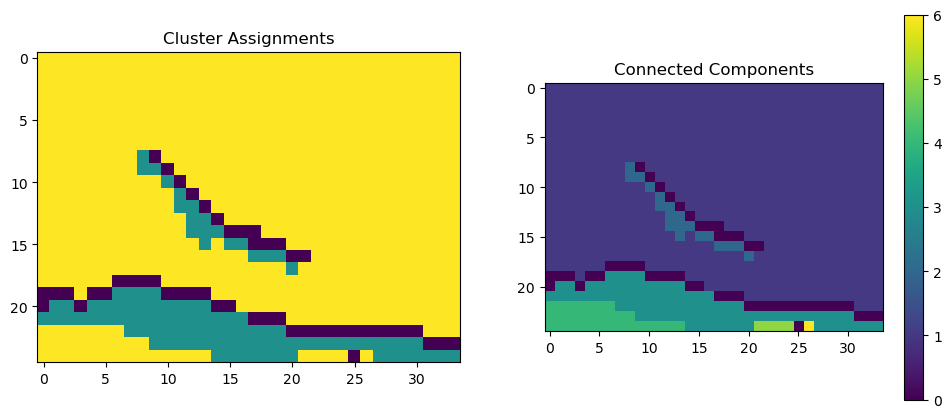

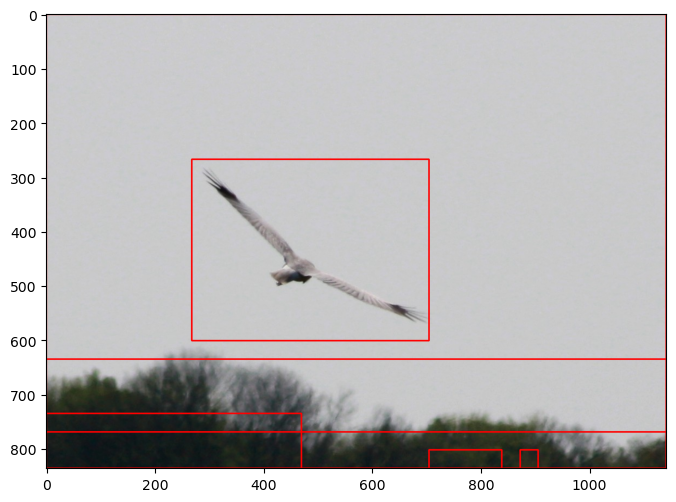

In [21]:
kmeans_cluster = KMeansCluster(hog_extractor, n_clusters=3, random_state=42)

# Plot the clusters and labels
kmeans_cluster.plot_cluster_and_labels()

# Get the bounding boxes of detected objects
bboxes = kmeans_cluster.get_bounding_boxes()


grid_shape = (len(kmeans_cluster.hog_extractor.hGrid), len(kmeans_cluster.hog_extractor.wGrid))

# ฟังก์ชันที่ใช้ในการรีเซ็ตภาพ
def reset_image(image):
    # Return a copy of the original image
    return image.copy()

# Draw the bounding boxes on the original image
image_copy = reset_image(image)
image_with_bboxes = draw_bbox(image_copy, bboxes, image_copy.shape, grid_shape)

# Display the image with bounding boxes
plt.figure(figsize=(8, 8))
plt.imshow(image_with_bboxes)
plt.show()

---

## Experiment
Do the experiment to identify 3 best parameters that produce the perfectly fitting bounding box of the object of interest in the image.

Number of grids: (26, 35)


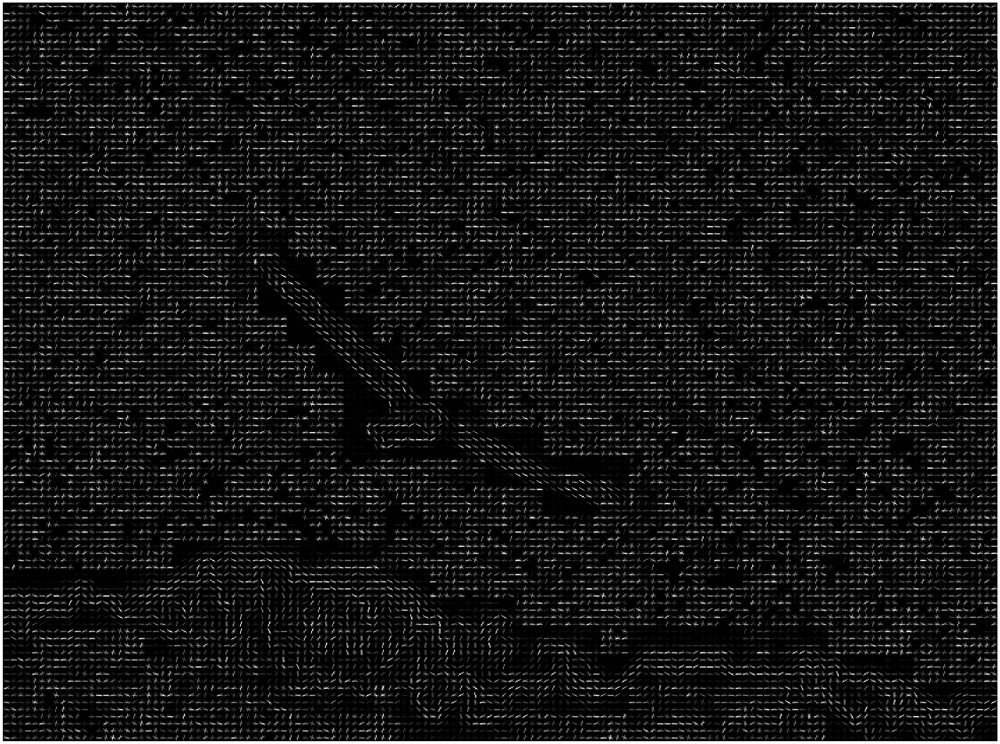

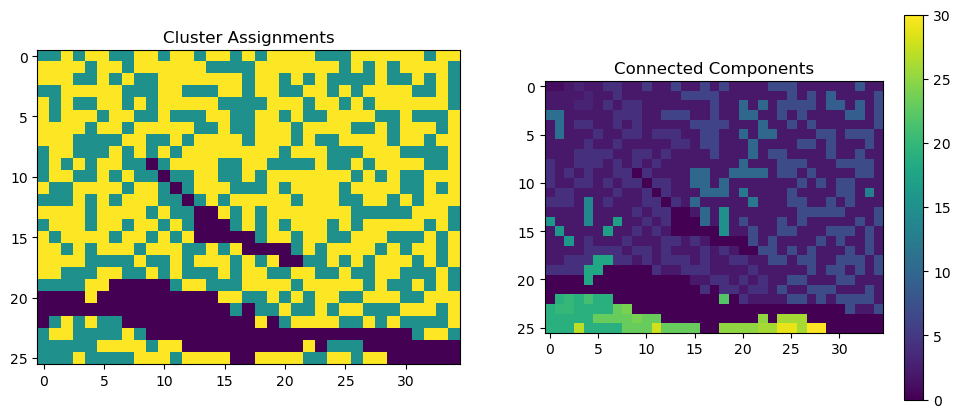

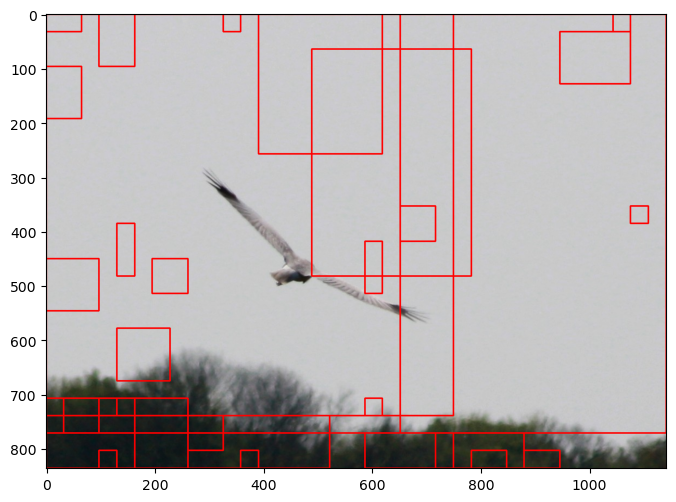

In [22]:
### START CODE HERE ###
tile_size = 32
stride = 32
hog_extractor = HOGSubimageExtractor(image, tile_size, stride)
num_grid = hog_extractor.get_num_grid()
print(f'Number of grids: {num_grid}')
hog_extractor.plot_hog_images()

kmeans_cluster = KMeansCluster(hog_extractor, n_clusters=3, random_state=42)

# Plot the clusters and labels
kmeans_cluster.plot_cluster_and_labels()

# Get the bounding boxes of detected objects
bboxes = kmeans_cluster.get_bounding_boxes()


grid_shape = (len(kmeans_cluster.hog_extractor.hGrid), len(kmeans_cluster.hog_extractor.wGrid))

# ฟังก์ชันที่ใช้ในการรีเซ็ตภาพ
def reset_image(image):
    # Return a copy of the original image
    return image.copy()

# Draw the bounding boxes on the original image
image_copy = reset_image(image)
image_with_bboxes = draw_bbox(image_copy, bboxes, image_copy.shape, grid_shape)

# Display the image with bounding boxes
plt.figure(figsize=(8, 8))
plt.imshow(image_with_bboxes)
plt.show()

### END CODE HERE ###

Number of grids: (13, 18)


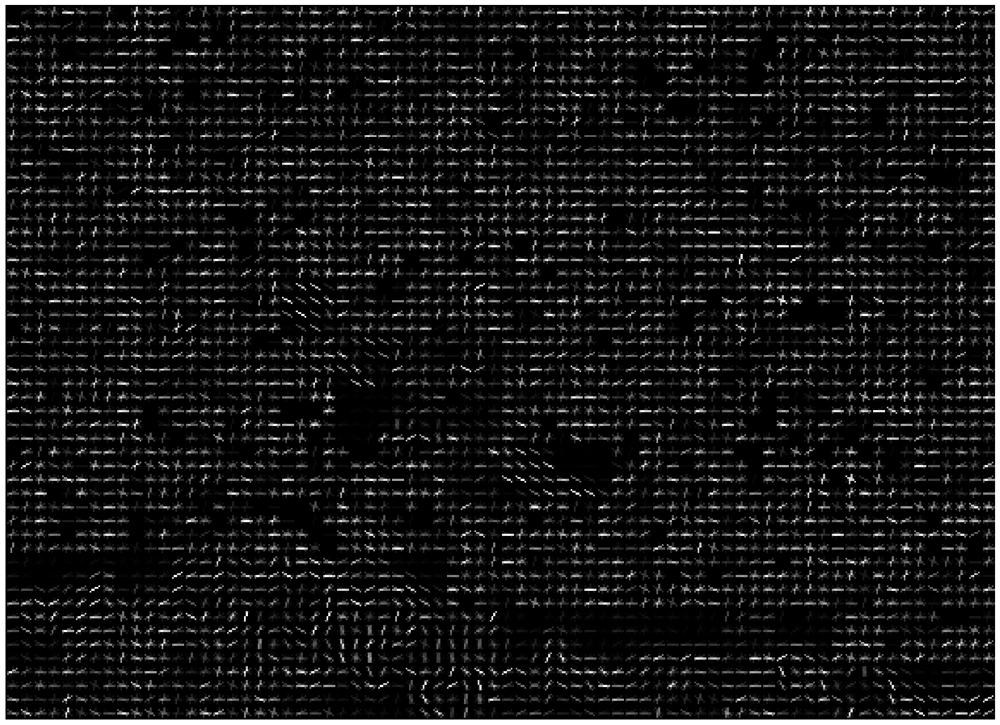

c:\Users\Acer\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


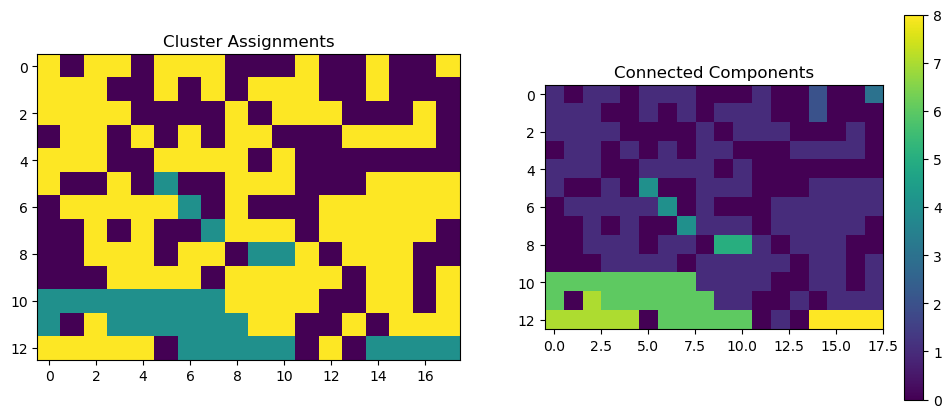

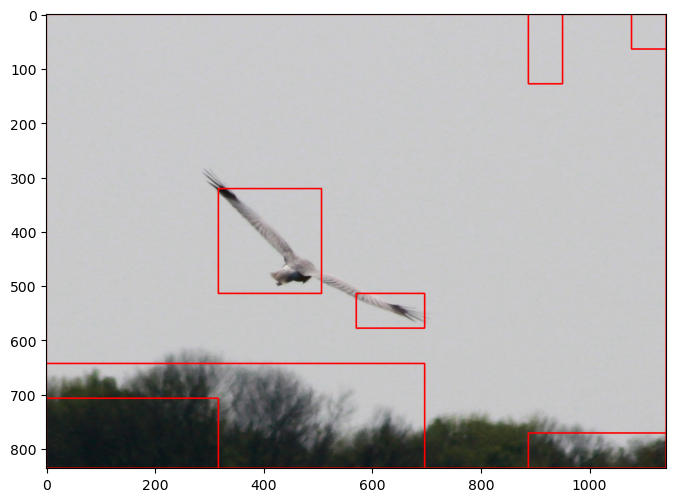

In [23]:
### START CODE HERE ###
tile_size = 32
stride = 64
hog_extractor = HOGSubimageExtractor(image, tile_size, stride)
num_grid = hog_extractor.get_num_grid()
print(f'Number of grids: {num_grid}')
hog_extractor.plot_hog_images()

kmeans_cluster = KMeansCluster(hog_extractor, n_clusters=3, random_state=42)

# Plot the clusters and labels
kmeans_cluster.plot_cluster_and_labels()

# Get the bounding boxes of detected objects
bboxes = kmeans_cluster.get_bounding_boxes()


grid_shape = (len(kmeans_cluster.hog_extractor.hGrid), len(kmeans_cluster.hog_extractor.wGrid))

# ฟังก์ชันที่ใช้ในการรีเซ็ตภาพ
def reset_image(image):
    # Return a copy of the original image
    return image.copy()

# Draw the bounding boxes on the original image
image_copy = reset_image(image)
image_with_bboxes = draw_bbox(image_copy, bboxes, image_copy.shape, grid_shape)

# Display the image with bounding boxes
plt.figure(figsize=(8, 8))
plt.imshow(image_with_bboxes)
plt.show()

### END CODE HERE ###

Number of grids: (32, 45)


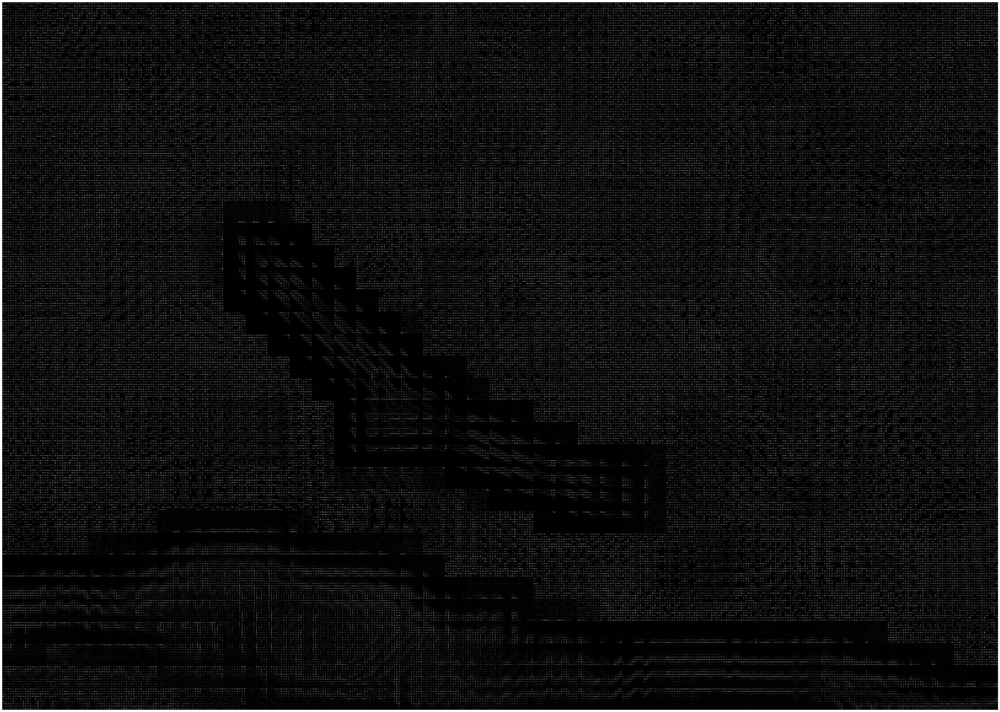

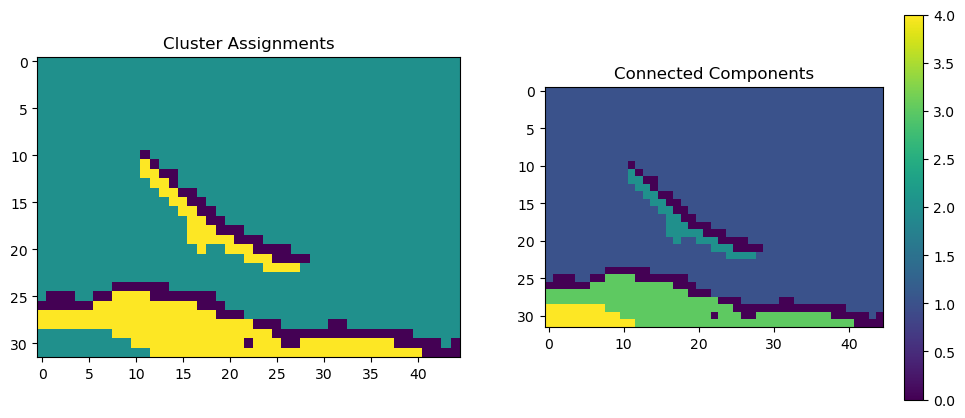

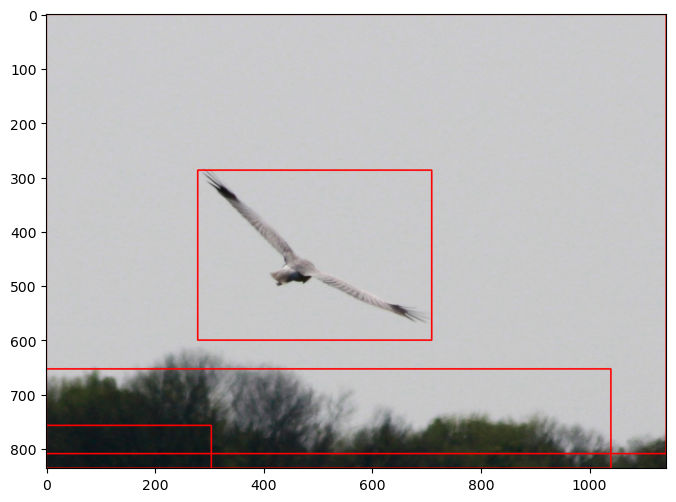

In [29]:
### START CODE HERE ###
tile_size = 72
stride = 24
hog_extractor = HOGSubimageExtractor(image, tile_size, stride)
num_grid = hog_extractor.get_num_grid()
print(f'Number of grids: {num_grid}')
hog_extractor.plot_hog_images()

kmeans_cluster = KMeansCluster(hog_extractor, n_clusters=3, random_state=42)

# Plot the clusters and labels
kmeans_cluster.plot_cluster_and_labels()

# Get the bounding boxes of detected objects
bboxes = kmeans_cluster.get_bounding_boxes()


grid_shape = (len(kmeans_cluster.hog_extractor.hGrid), len(kmeans_cluster.hog_extractor.wGrid))

# ฟังก์ชันที่ใช้ในการรีเซ็ตภาพ
def reset_image(image):
    # Return a copy of the original image
    return image.copy()

# Draw the bounding boxes on the original image
image_copy = reset_image(image)
image_with_bboxes = draw_bbox(image_copy, bboxes, image_copy.shape, grid_shape)

# Display the image with bounding boxes
plt.figure(figsize=(8, 8))
plt.imshow(image_with_bboxes)
plt.show()

### END CODE HERE ###

---

## **Question** 
1. How do the parameters of Gaussian blur, such as kernel size and standard deviation, affect the image processing in the context of k-means clustering?

2. How do the configurations of cells per block and pixels per cell influence the effectiveness of object detection in an image?

3. What differences can be observed in the clustering results when using smaller sub-images (tiles) compared to larger ones?

4. What is the impact on object detection if the labeling step is skipped before applying k-means clustering?

5. How does the choice of the number of clusters (K) in k-means clustering affect the image clustering result (right) of an input image (left)? 
Discuss the trade-offs between too few and too many clusters in accurately representing the test patterns.<br>

![q5.jpg](https://github.com/Digital-Image-Processing-Laboratory/image_processing-2024/blob/master/Lab4_Image-Segmentation/asset/q5.jpg?raw=true)


## **Answer** 
1.  <b>Kernel size</b>: <br/>
    ขนาดของ kernel คือ ขนาดของเมทริกซ์ที่ใช้ในกระบวนการเบลอภาพ<br/>
    <b>ขนาด Kernel ใหญ่</b> :    
    - ภาพถูกเบลอมากขึ้น, รายละเอียดของภาพถูกลดลง -> ลด noise ได้ แต่อาจทำให้รายละเอียดที่สำคัญสูญหาย 
    - การที่เบลอภาพมากเกินไป อาจจะทำให้กลุ่มที่แตกต่างกันรวมกันเป็นกลุ่มใหญ่ๆได้ น้อยลง

    <b>ขนาด Kernel เล็ก</b> :    
    - เก็บรายละเอียดได้มากขึ้น ซึ่งอาจทำให้มีการจัดกลุ่มที่แม่นยำมากขึ้น แต่มี noise มากขึ้นเช่นกัน
    ---
    <b>standard deviation (σ)</b>: <br/>
    ค่าความเบี่ยงเบนมาตรฐานของ Gaussian kernel : ควบคุมปริมาณการกระจายของการเบลอ กำหนดว่าการมีอิทธิพลของแต่ละพิกเซลขยายออกไปไกลแค่ไหน
    <b>standard deviation สูง</b> :    
    - การเบลอภาพมีการกระจายกว้างขึ้น ส่งผลให้การเบลอมีผลต่อพื้นที่ที่กว้างขึ้น
    - ทำให้ภาพดูเหมือนเป็นเนื้อเดียวกันมากขึ้นและทำให้ขอบเขตของพื้นที่ต่างๆ เบลอลง ซึ่งอาจทำให้การจัดกลุ่มง่ายขึ้นโดยลดจำนวนพื้นที่ที่แตกต่างกัน แต่ก็อาจทำให้กลุ่มที่แตกต่างกันรวมกัน

    <b>standard deviation ต่ำ</b> :    
    - จำกัดผลกระทบของการเบลอให้แคบลง, รักษารายละเอียดและขอบของภาพมากขึ้น
    - จะเก็บรายละเอียดพื้นที่ และทำให้มีการจัดกลุ่มที่แม่นยำมากขึ้น แต่ก็อาจมี noise มากขึ้นเช่นกัน
    ---
    <b>ผลกระทบ</b> :
    <b>ขนาด Kernel ใหญ่ / ค่าความเบี่ยงเบนมาตรฐานสูง</b>: <br/>
    - ข้อดี: ลด noise และเบลอภาพ ซึ่งอาจช่วยในการจัดกลุ่มโดยลดผลกระทบของความแปรปรวนสุ่ม
    - ข้อเสีย: อาจเบลอรายละเอียดสำคัญ และทำให้ลักษณะเด่นรวมกันเป็นกลุ่มที่ใหญ่ และน้อยลง

    <b>ขนาด Kernel เล็ก / ค่าความเบี่ยงเบนมาตรฐานต่ำ</b>: <br/>
    - ข้อดี: รักษารายละเอียดที่ละเอียดและลักษณะเด่น ซึ่งอาจนำไปสู่การจัดกลุ่มที่แม่นยำและมีความหมายมากขึ้น
    - ข้อเสีย: อาจรักษาความแปรปรวนและ noise ซึ่งอาจทำให้กระบวนการจัดกลุ่มซับซ้อนและนำไปสู่การมีจำนวนกลุ่มที่มากขึ้นพร้อมขอบเขตที่ไม่ชัดเจน<br/>
    ---
2.  <b>Pixels Per Cell</b>: <br/>
    Pixels per cell หมายถึง ขนาดของพื้นที่ในภาพที่ใช้ในการคำนวณฮิสโตแกรมของเกรเดียนต์ (gradient histogram)<br/>
    <b>ขนาด Pixels Per Cell ใหญ่</b> :    
    - ช่วยในการตรวจจับลักษณะที่ใหญ่ขึ้นและวัตถุขนาดใหญ่ แต่การรักษารายละเอียดที่ละเอียดอาจลดลง ทำให้การตรวจจับรายละเอียดเล็กๆ มีความแม่นยำน้อยลง
    - ลดจำนวนเซลล์ที่ต้องประมวลผล ซึ่งช่วยลดความต้องการด้านการคำนวณและหน่วยความจำ แต่การบรรยายลักษณะอาจลดลง

    <b>ขนาด Pixels Per Cell เล็ก</b> :    
    - จับรายละเอียดที่ละเอียดมากขึ้นและดีต่อการตรวจจับลักษณะเล็กๆ หรือรูปแบบที่ซับซ้อน
    - เพิ่มจำนวนเซลล์ที่ต้องประมวลผล ซึ่งอาจทำให้มีความต้องการด้านการคำนวณและหน่วยความจำสูงขึ้น
    ---
    <b>Cells Per Block</b>: <br/>
    จำนวนเซลล์ที่ถูกจัดกลุ่มเข้าด้วยกันเพื่อสร้างบล็อกสำหรับการทำให้ปกติ (normalization) ของฮิสโตแกรม<br/>
    <b>Cells Per Block มาก</b> :    
    - เพิ่มความทนทานของฟีเจอร์เวกเตอร์ต่อการเปลี่ยนแปลงในแสงและคอนทราสต์ ซึ่งจะทำให้การตรวจจับวัตถุในสภาพแสงที่แตกต่างกันมีความแม่นยำมากขึ้น แต่การจับข้อมูลในพื้นที่เล็กๆ อาจลดลง

    <b>Cells Per Block น้อย</b> :    
    - เวกเตอร์มีความทนทานน้อยลงต่อการเปลี่ยนแปลงในแสงและคอนทราสต์ แต่ก็จับข้อมูลในพื้นที่ที่ละเอียดมากขึ้น
    ---
3.  <b>ขนาด Tiles ใหญ่</b> :    
    - จับพื้นที่กว้างขึ้นในภาพ ซึ่งช่วยในการเข้าใจลักษณะทั่วไปและโครงสร้างรวมถึงลักษณะใหญ่ๆ มากกว่ารายละเอียดเล็กๆ
    - ลดจำนวนกลุ่มลง เนื่องจากแต่ละ tile ครอบคลุมข้อมูลกว้างขึ้น ทำให้การแทนที่ภาพเป็นไปอย่างรวมกลุ่มมากขึ้น
    - ช่วยลดผลกระทบของ noise และการเปลี่ยนแปลง ซึ่งอาจทำให้กลุ่มที่สร้างขึ้นมีลักษณะที่ดีขึ้น และแทนที่ลักษณะสำคัญได้ดีขึ้น
    - การรวมบริบทที่กว้างขึ้นช่วยในการจับความสัมพันธ์ทางพื้นที่ที่ครบถ้วนมากขึ้น ทำให้กลุ่มที่สร้างขึ้นแทนที่เนื้อหาของภาพได้ดีขึ้น
    - การด้านการคำนวณและหน่วยความจำน้อยลง เนื่องจากแต่ละ tile ขนาดใหญ่แทนที่ส่วนใหญ่ของภาพ
    - ทำให้กลุ่มที่ได้มีความหมายและแทนที่ลักษณะที่สำคัญหรือวัตถุได้ดีขึ้น ซึ่งมักทำให้ผลลัพธ์ของการจัดกลุ่มมีความหมายและตีความได้ง่ายขึ้น
    - การมองภาพรวมที่ดีขึ้น ซึ่งช่วยให้การตรวจจับวัตถุและการแยกประเภทมีความแม่นยำมากขึ้น

    <b>ขนาด Tiles เล็ก</b> :    
    - จับรายละเอียดที่ละเอียดมากขึ้น ซึ่งดีสำหรับการตรวจจับลักษณะหรือรูปแบบที่ซับซ้อนและเล็ก
    - จำนวนกลุ่มมากขึ้น เนื่องจากแต่ละ tile ขนาดเล็กสามารถแทนที่ลักษณะหรือรูปแบบที่แตกต่างกันได้
    - ไวต่อ noise และการเปลี่ยนแปลง ซึ่งอาจทำให้เกิดการสร้างกลุ่มที่ไม่เป็นสาระสำคัญ
    - ยากต่อการจับความสัมพันธ์ทางพื้นที่ระหว่างส่วนต่างๆ ของภาพ ผลลัพธ์คือกลุ่มที่สร้างขึ้นอาจมีลักษณะที่แยกออกจากกันและไม่เป็นระเบียบในแง่ของโครงสร้างรวม
    - มีความต้องการด้านการคำนวณและหน่วยความจำสูงขึ้น เนื่องจากแต่ละ tile ต้องได้รับการประมวลผลและจัดกลุ่มแยกต่างหาก
    - ทำให้เกิดการแยกกลุ่มเกินไปซึ่งแทนที่ลักษณะที่เป็นพื้นที่เล็กๆ กลุ่มเหล่านี้อาจไม่ตรงกับวัตถุหรือลักษณะที่มีความหมาย
    - แสดงความแปรปรวนที่สูงขึ้นเนื่องจากเสียงรบกวนและรายละเอียดท้องถิ่น ซึ่งทำให้การตีความผลลัพธ์ยากขึ้น
    ---
4. <b>ขาดการแนะนำจากข้อมูลที่ label</b> :    
    - K-means clustering เป็นวิธีการเรียนรู้แบบไม่ต้องมีการควบคุม (unsupervised learning) ซึ่งไม่ต้องการข้อมูลที่มีป้ายกำกับ การไม่มีป้ายกำกับทำให้ k-means จัดกลุ่มข้อมูลตามความคล้ายคลึงในพื้นที่คุณลักษณะโดยไม่มีการแนะนำว่ากลุ่มเหล่านี้ควรแทนที่วัตถุประเภทใด.
    - กลุ่มที่สร้างขึ้นอาจไม่ตรงกับวัตถุที่มีความหมายในภาพ กลุ่มที่ได้อาจสะท้อนการจัดกลุ่มตามโครงสร้างของฟีเจอร์ที่ไม่สอดคล้องกับวัตถุหรือคุณลักษณะที่ต้องการ

    <b>ไม่แม่นยำหรือไม่มีความหมาย</b> :    
    - K-means clustering เริ่มต้นด้วยการกำหนดศูนย์กลางของกลุ่มแบบสุ่มและปรับค่าตามลำดับ ในกรณีที่ไม่มีป้ายกำกับ ศูนย์กลางกลุ่มเริ่มต้นและการปรับเปลี่ยนหลังจากนั้นอาจไม่ตรงกับขอบเขตของวัตถุจริงหรือฟีเจอร์ที่มีความหมาย
    - กลุ่มที่ได้อาจไม่สะท้อนวัตถุหรือฟีเจอร์ที่ชัดเจน แทนที่อาจสะท้อนเสียงรบกวนหรือรูปแบบที่ไม่สำคัญ ซึ่งส่งผลให้การตรวจจับไม่แม่นยำ
    - อาจทำให้กลุ่มไม่ตรงกับขอบเขตของวัตถุจริงหรือรูปร่าง ซึ่งอาจทำให้กลุ่มที่สร้างขึ้นไม่สอดคล้องกับวัตถุในภาพจริง

    <b>ยากจ่อการประเมินและตรวจสอบ</b> :    
    - ยากต่อการประเมินคุณภาพและความแม่นยำของกลุ่ม ไม่มีข้อมูลพื้นฐานให้เปรียบเทียบ ทำให้ยากในการประเมินว่ากลุ่มตรงกับวัตถุหรือฟีเจอร์ที่มีความหมายหรือไม่
    - ตัวชี้วัดประสิทธิภาพ เช่น ความแม่นยำ (precision), recall, หรือคะแนน F1 ต้องอิงจากข้อมูลที่มีป้ายกำกับเพื่อตรวจสอบความแม่นยำของการตรวจจับ การข้ามขั้นตอนการติดป้ายทำให้ไม่สามารถคำนวณตัวชี้วัดเหล่านี้ได้
    - อาจทำให้กลุ่มไม่ตรงกับขอบเขตของวัตถุจริงหรือรูปร่าง ซึ่งอาจทำให้กลุ่มที่สร้างขึ้นไม่สอดคล้องกับวัตถุในภาพจริง

    <b>ประสิทธิภาพการตรวจจับวัตถุที่อาจไม่ดี</b> :    
    - การจัดกลุ่มโดยไม่มีป้ายกำกับอาจทำให้ประสิทธิภาพการตรวจจับวัตถุแย่ลง โดยมีข้อผิดพลาดเชิงบวก (false positives) ที่เพิ่มขึ้น (การระบุพื้นที่เป็นวัตถุผิด) และข้อผิดพลาดเชิงลบ (false negatives) ที่เพิ่มขึ้น (การไม่ตรวจจับวัตถุจริง)
    - การตีความและการเข้าใจว่ากลุ่มแต่ละกลุ่มหมายถึงอะไรเป็นเรื่องที่ยากโดยไม่มีการติดป้าย การขาดการตีความนี้อาจส่งผลต่อการใช้งานจริงของผลลัพธ์การจัดกลุ่ม
    ---
5.  <b>จำนวนกลุ่มน้อยเกินไป</b>:
    - ภาพรวมของภาพจะง่ายเกินไป อาจรวมพื้นที่สีที่แตกต่างกันเข้าด้วยกัน ทำให้แยกแยะรูปแบบต่างๆ ได้ยาก
    - ขาดรายละเอียดปลีกย่อย เนื่องจากการรวมกลุ่มภาพแบบคร่าวๆ

    <b>จำนวนกลุ่มมากเกินไป</b> :    
    - ภาพอาจซับซ้อนเกินไป จนแยกแยะกลุ่มสีที่ไม่มีความหมายได้
    - ใช้เวลานานในการคำนวณ

    <b>ในกรณีของภาพทดสอบสายตาสี</b>:
    - ค่า K ต่ำ : อาจเพียงพอที่จะแยกตัวเลขออกจากพื้นหลัง แต่ไม่สามารถระบุตัวเลขได้อย่างแม่นยำ
    - ค่า K สูง : อาจจับรายละเอียดของตัวเลขได้ดีขึ้น แต่เสี่ยงต่อการแบ่งกลุ่มภาพมากเกินไป จนไม่สามารถระบุตัวเลขได้
    ---